In [1]:
import oversampling_binary
import matplotlib.pyplot as plt
import numpy as np
from resample import resample_dataset
import exp1, exp2
import features
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix

In [2]:
import os
os.environ["LOKY_MAX_CPU_COUNT"] = "4"  # Adatta questo valore al numero di core che desideri utilizzare

In [3]:
dataset_path = "C:/Users/mario/OneDrive/Desktop/Resample_exp"

# PRIMO SET

## SAMPLE RATE 44100

In [4]:
resample_dataset(dataset_path, sr=44100)

File C:/Users/mario/OneDrive/Desktop/Resample_exp\Non-Target\Ambient Noise\0f9867d8-fcf7-40d1-b846-3f7fb8100eb7_seg1.wav ricampionato a 44100 Hz e sovrascritto.
File C:/Users/mario/OneDrive/Desktop/Resample_exp\Non-Target\Ambient Noise\0f9867d8-fcf7-40d1-b846-3f7fb8100eb7_seg2.wav ricampionato a 44100 Hz e sovrascritto.
File C:/Users/mario/OneDrive/Desktop/Resample_exp\Non-Target\Ambient Noise\0f9867d8-fcf7-40d1-b846-3f7fb8100eb7_seg3.wav ricampionato a 44100 Hz e sovrascritto.
File C:/Users/mario/OneDrive/Desktop/Resample_exp\Non-Target\Ambient Noise\0f9867d8-fcf7-40d1-b846-3f7fb8100eb7_seg4.wav ricampionato a 44100 Hz e sovrascritto.
File C:/Users/mario/OneDrive/Desktop/Resample_exp\Non-Target\Ambient Noise\0f9867d8-fcf7-40d1-b846-3f7fb8100eb7_seg5.wav ricampionato a 44100 Hz e sovrascritto.
File C:/Users/mario/OneDrive/Desktop/Resample_exp\Non-Target\Ambient Noise\0f9867d8-fcf7-40d1-b846-3f7fb8100eb7_seg6.wav ricampionato a 44100 Hz e sovrascritto.
File C:/Users/mario/OneDrive/Deskt

In [6]:
df_44100 = features.extract_features_from_directory(dataset_path)

Processing audio files:   0%|          | 219/50993 [00:13<57:35, 14.69file/s] C:\Users\mario\AppData\Local\Programs\Python\Python310\lib\site-packages\numpy\core\fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\mario\AppData\Local\Programs\Python\Python310\lib\site-packages\numpy\core\_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\mario\AppData\Local\Programs\Python\Python310\lib\site-packages\numpy\core\_methods.py:129: RuntimeWarning: invalid value encountered in divide
  ret = ret.dtype.type(ret / rcount)
C:\underwater-classification\features.py:68: RuntimeWarning: invalid value encountered in scalar divide
  return np.max(y) / np.mean(y)
C:\underwater-classification\features.py:72: RuntimeWarning: invalid value encountered in scalar divide
  return np.min(y) / np.mean(y)
Processing audio files: 100%|██████████| 50993/50993 [55:20<00:00, 15.

In [7]:
df_44100.to_csv("resampled_44100_exp1.csv", index=False)

In [8]:
#SPLIT
X_train_imputed_44100, X_val_imputed_44100, X_test_imputed_44100, y_train_encoded_filtered_44100, y_val_encoded_44100, y_test_encoded_44100, subclasses_train, class_encoder_44100 = oversampling_binary.split_dataset("resampled_44100_exp1.csv")

Distribuzione delle classi nel set di addestramento:
Class
Target        34635
Non-Target     5791
Name: count, dtype: int64
Distribuzione delle subclassi nel set di addestramento:
Subclass
Tanker                      9181
Passengership               8847
Tug                         8539
Cargo                       7705
Sperm Whale                 1087
                            ... 
Ringed Seal                    2
Short-finned Pilot Whale       2
Black Drum                     2
Pygmy Right Whale              1
True_s beaked whale            1
Name: count, Length: 107, dtype: int64
Dimensioni del set di addestramento: (40426, 15) (40426,)
Dimensioni del set di validazione: (4333, 15) (4333,)
Dimensioni del set di test: (6234, 15) (6234,)


In [9]:
#SMOTE
X_train_resampled_44100, y_train_resampled_44100 = oversampling_binary.apply_smote(X_train_imputed_44100, y_train_encoded_filtered_44100, subclasses_train)

SMOTE tra le subclass di Target:
Distribuzione subclassi di Target dopo SMOTE:
Subclass
Acoustic Harassment Devices         9181
Acoustic release                    9181
Cargo                               9181
Echosounder                         9181
Explosion                           9181
Fishing pinger                      9181
Passengership                       9181
Scuba divers                        9181
Seafloor fossil fuel processing     9181
Seal bomb                           9181
Seismic airguns surveys             9181
Sonar                               9181
Tanker                              9181
Tug                                 9181
Underwater Communication Signals    9181
Vessel                              9181
Name: count, dtype: int64
SMOTE tra le subclass di Non-Target:
Distribuzione subclassi di Non-Target dopo SMOTE:
Subclass
Ambient Noise         1087
Manatee               1087
Right whale           1087
Red grouper           1087
Rain                  1087

In [10]:
y_train_resampled_44100 = y_train_resampled_44100.astype(int)
y_val_encoded_44100 = y_val_encoded_44100.astype(int)
y_test_encoded_44100 = y_test_encoded_44100.astype(int)

In [11]:
lightgbm_model_44100 = oversampling_binary.train_lightgbm(
    X_train_resampled_44100,
    y_train_resampled_44100,
    X_val_imputed_44100,
    y_val_encoded_44100,
    X_test_imputed_44100,  
    y_test_encoded_44100
)

Training Progress:   0%|          | 0/10 [00:00<?, ?it/s]

[LightGBM] [Warning] Contains only one class
[LightGBM] [Info] Number of positive: 0, number of negative: 29379
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001061 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 3825
[LightGBM] [Info] Number of data points in the train set: 29379, number of used features: 15
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.000000 -> initscore=-34.538776
[LightGBM] [Info] Start training from score -34.538776
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the sp

Training Progress:  30%|███       | 3/10 [00:00<00:00, 16.41it/s]

[LightGBM] [Warning] Contains only one class
[LightGBM] [Info] Number of positive: 0, number of negative: 88137
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.003933 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3825
[LightGBM] [Info] Number of data points in the train set: 88137, number of used features: 15
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.000000 -> initscore=-34.538776
[LightGBM] [Info] Start training from score -34.538776
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because t

Training Progress:  50%|█████     | 5/10 [00:00<00:00, 10.43it/s]

[LightGBM] [Warning] Contains only one class
[LightGBM] [Info] Number of positive: 0, number of negative: 146895
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.004524 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3825
[LightGBM] [Info] Number of data points in the train set: 146895, number of used features: 15
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.000000 -> initscore=-34.538776
[LightGBM] [Info] Start training from score -34.538776
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because

Training Progress:  70%|███████   | 7/10 [00:01<00:00,  3.02it/s]

[LightGBM] [Info] Number of positive: 146896, number of negative: 88136
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.010418 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3825
[LightGBM] [Info] Number of data points in the train set: 235032, number of used features: 15
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.625004 -> initscore=0.510844
[LightGBM] [Info] Start training from score 0.510844


Training Progress:  80%|████████  | 8/10 [00:02<00:00,  2.17it/s]

[LightGBM] [Info] Number of positive: 146896, number of negative: 117515
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.013285 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3825
[LightGBM] [Info] Number of data points in the train set: 264411, number of used features: 15
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.555559 -> initscore=0.223159
[LightGBM] [Info] Start training from score 0.223159


Training Progress:  90%|█████████ | 9/10 [00:03<00:00,  1.63it/s]

[LightGBM] [Info] Number of positive: 146896, number of negative: 146894
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.011326 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3825
[LightGBM] [Info] Number of data points in the train set: 293790, number of used features: 15
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500003 -> initscore=0.000014
[LightGBM] [Info] Start training from score 0.000014


Training Progress: 100%|██████████| 10/10 [00:04<00:00,  2.10it/s]

Distribuzione delle classi reali (validazione): [ 906 3427]
Distribuzione delle classi predette (validazione): [ 904 3429]
Report di classificazione del set di validazione:
              precision    recall  f1-score   support

           0       0.96      0.95      0.95       906
           1       0.99      0.99      0.99      3427

    accuracy                           0.98      4333
   macro avg       0.97      0.97      0.97      4333
weighted avg       0.98      0.98      0.98      4333

Accuratezza sul set di validazione: 0.9811
Distribuzione delle classi reali (test): [1115 5119]
Distribuzione delle classi predette (test): [ 751 5483]
Report di classificazione del set di test:
              precision    recall  f1-score   support

           0       0.95      0.64      0.77      1115
           1       0.93      0.99      0.96      5119

    accuracy                           0.93      6234
   macro avg       0.94      0.82      0.86      6234
weighted avg       0.93      0.93

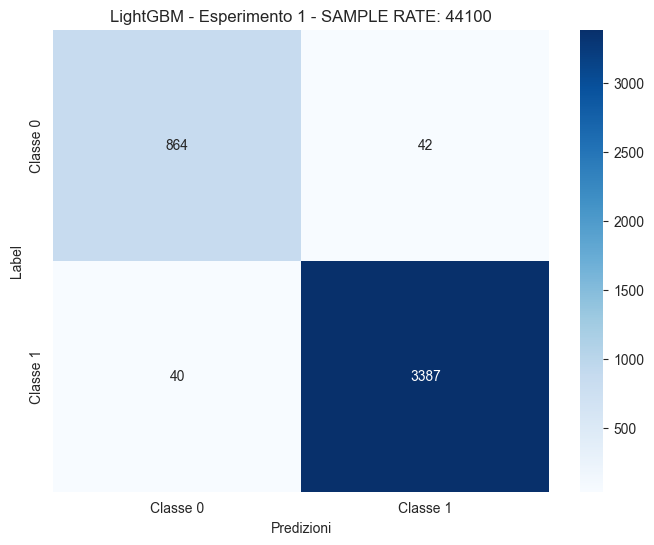

In [12]:
# 1. Effettua le predizioni sul set di convalida
y_pred_lightgbm_44100 = lightgbm_model_44100.predict(X_val_imputed_44100)

# Se il modello restituisce probabilità, ottieni le etichette predette
y_pred_lightgbm_44100 = (y_pred_lightgbm_44100 > 0.5).astype(int)  # Usa la soglia di 0.5 per la classificazione binaria

# 2. Calcola la matrice di confusione
cm_lightgbm_44100 = confusion_matrix(y_val_encoded_44100, y_pred_lightgbm_44100)

# 3. Visualizza la matrice di confusione
plt.figure(figsize=(8, 6))
sns.heatmap(cm_lightgbm_44100, annot=True, fmt='d', cmap='Blues', xticklabels=['Classe 0', 'Classe 1'], yticklabels=['Classe 0', 'Classe 1'])
plt.xlabel('Predizioni')
plt.ylabel('Label')
plt.title('LightGBM - Esperimento 1 - SAMPLE RATE: 44100')
plt.show()

## SAMPLE RATE 192000

In [13]:
resample_dataset(dataset_path, sr=192000)

File C:/Users/mario/OneDrive/Desktop/Resample_exp\Non-Target\Ambient Noise\0f9867d8-fcf7-40d1-b846-3f7fb8100eb7_seg1.wav ricampionato a 192000 Hz e sovrascritto.
File C:/Users/mario/OneDrive/Desktop/Resample_exp\Non-Target\Ambient Noise\0f9867d8-fcf7-40d1-b846-3f7fb8100eb7_seg2.wav ricampionato a 192000 Hz e sovrascritto.
File C:/Users/mario/OneDrive/Desktop/Resample_exp\Non-Target\Ambient Noise\0f9867d8-fcf7-40d1-b846-3f7fb8100eb7_seg3.wav ricampionato a 192000 Hz e sovrascritto.
File C:/Users/mario/OneDrive/Desktop/Resample_exp\Non-Target\Ambient Noise\0f9867d8-fcf7-40d1-b846-3f7fb8100eb7_seg4.wav ricampionato a 192000 Hz e sovrascritto.
File C:/Users/mario/OneDrive/Desktop/Resample_exp\Non-Target\Ambient Noise\0f9867d8-fcf7-40d1-b846-3f7fb8100eb7_seg5.wav ricampionato a 192000 Hz e sovrascritto.
File C:/Users/mario/OneDrive/Desktop/Resample_exp\Non-Target\Ambient Noise\0f9867d8-fcf7-40d1-b846-3f7fb8100eb7_seg6.wav ricampionato a 192000 Hz e sovrascritto.
File C:/Users/mario/OneDrive

In [15]:
df_19200 = features.extract_features_from_directory(dataset_path)

Processing audio files:   0%|          | 0/50993 [00:00<?, ?file/s]C:\Users\mario\AppData\Local\Programs\Python\Python310\lib\site-packages\librosa\feature\spectral.py:2143: UserWarning: Empty filters detected in mel frequency basis. Some channels will produce empty responses. Try increasing your sampling rate (and fmax) or reducing n_mels.
  mel_basis = filters.mel(sr=sr, n_fft=n_fft, **kwargs)
Processing audio files:   0%|          | 219/50993 [00:44<2:50:01,  4.98file/s]C:\Users\mario\AppData\Local\Programs\Python\Python310\lib\site-packages\numpy\core\fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\mario\AppData\Local\Programs\Python\Python310\lib\site-packages\numpy\core\_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\mario\AppData\Local\Programs\Python\Python310\lib\site-packages\numpy\core\_methods.py:129: RuntimeWarning: invalid value e

In [16]:
df_19200.to_csv("resampled_19200_exp1.csv", index=False)

In [17]:
#SPLIT
X_train_imputed_19200, X_val_imputed_19200, X_test_imputed_19200, y_train_encoded_filtered_19200, y_val_encoded_19200, y_test_encoded_19200, subclasses_train, class_encoder_19200 = oversampling_binary.split_dataset("resampled_19200_exp1.csv")

Distribuzione delle classi nel set di addestramento:
Class
Target        34635
Non-Target     5791
Name: count, dtype: int64
Distribuzione delle subclassi nel set di addestramento:
Subclass
Tanker                      9181
Passengership               8847
Tug                         8539
Cargo                       7705
Sperm Whale                 1087
                            ... 
Ringed Seal                    2
Short-finned Pilot Whale       2
Black Drum                     2
Pygmy Right Whale              1
True_s beaked whale            1
Name: count, Length: 107, dtype: int64
Dimensioni del set di addestramento: (40426, 15) (40426,)
Dimensioni del set di validazione: (4333, 15) (4333,)
Dimensioni del set di test: (6234, 15) (6234,)


In [18]:
#SMOTE
X_train_resampled_19200, y_train_resampled_19200 = oversampling_binary.apply_smote(X_train_imputed_19200, y_train_encoded_filtered_19200, subclasses_train)

SMOTE tra le subclass di Target:
Distribuzione subclassi di Target dopo SMOTE:
Subclass
Acoustic Harassment Devices         9181
Acoustic release                    9181
Cargo                               9181
Echosounder                         9181
Explosion                           9181
Fishing pinger                      9181
Passengership                       9181
Scuba divers                        9181
Seafloor fossil fuel processing     9181
Seal bomb                           9181
Seismic airguns surveys             9181
Sonar                               9181
Tanker                              9181
Tug                                 9181
Underwater Communication Signals    9181
Vessel                              9181
Name: count, dtype: int64
SMOTE tra le subclass di Non-Target:
Distribuzione subclassi di Non-Target dopo SMOTE:
Subclass
Ambient Noise         1087
Manatee               1087
Right whale           1087
Red grouper           1087
Rain                  1087

In [19]:
y_train_resampled_19200 = y_train_resampled_19200.astype(int)
y_val_encoded_19200 = y_val_encoded_19200.astype(int)
y_test_encoded_19200 = y_test_encoded_19200.astype(int)

In [20]:
lightgbm_model_19200 = oversampling_binary.train_lightgbm(
    X_train_resampled_19200,
    y_train_resampled_19200,
    X_val_imputed_19200,
    y_val_encoded_19200,
    X_test_imputed_19200,  
    y_test_encoded_19200
)

Training Progress:  30%|███       | 3/10 [00:00<00:00, 19.87it/s]

[LightGBM] [Warning] Contains only one class
[LightGBM] [Info] Number of positive: 0, number of negative: 29379
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001001 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3825
[LightGBM] [Info] Number of data points in the train set: 29379, number of used features: 15
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.000000 -> initscore=-34.538776
[LightGBM] [Info] Start training from score -34.538776
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because t

Training Progress:  50%|█████     | 5/10 [00:00<00:00, 12.02it/s]

[LightGBM] [Warning] Contains only one class
[LightGBM] [Info] Number of positive: 0, number of negative: 117516
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.004520 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3825
[LightGBM] [Info] Number of data points in the train set: 117516, number of used features: 15
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.000000 -> initscore=-34.538776
[LightGBM] [Info] Start training from score -34.538776
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because

Training Progress:  70%|███████   | 7/10 [00:01<00:00,  3.21it/s]

[LightGBM] [Info] Number of positive: 146896, number of negative: 88136
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.010953 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3825
[LightGBM] [Info] Number of data points in the train set: 235032, number of used features: 15
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.625004 -> initscore=0.510844
[LightGBM] [Info] Start training from score 0.510844


Training Progress:  80%|████████  | 8/10 [00:02<00:00,  2.45it/s]

[LightGBM] [Info] Number of positive: 146896, number of negative: 117515
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002063 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 3825
[LightGBM] [Info] Number of data points in the train set: 264411, number of used features: 15
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.555559 -> initscore=0.223159
[LightGBM] [Info] Start training from score 0.223159


Training Progress:  90%|█████████ | 9/10 [00:03<00:00,  2.03it/s]

[LightGBM] [Info] Number of positive: 146896, number of negative: 146894
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.009684 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3825
[LightGBM] [Info] Number of data points in the train set: 293790, number of used features: 15
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500003 -> initscore=0.000014
[LightGBM] [Info] Start training from score 0.000014


Training Progress: 100%|██████████| 10/10 [00:04<00:00,  2.48it/s]

Distribuzione delle classi reali (validazione): [ 906 3427]
Distribuzione delle classi predette (validazione): [ 909 3424]
Report di classificazione del set di validazione:
              precision    recall  f1-score   support

           0       0.95      0.95      0.95       906
           1       0.99      0.99      0.99      3427

    accuracy                           0.98      4333
   macro avg       0.97      0.97      0.97      4333
weighted avg       0.98      0.98      0.98      4333

Accuratezza sul set di validazione: 0.9785
Distribuzione delle classi reali (test): [1115 5119]
Distribuzione delle classi predette (test): [ 675 5559]
Report di classificazione del set di test:
              precision    recall  f1-score   support

           0       0.93      0.56      0.70      1115
           1       0.91      0.99      0.95      5119

    accuracy                           0.91      6234
   macro avg       0.92      0.78      0.83      6234
weighted avg       0.92      0.91

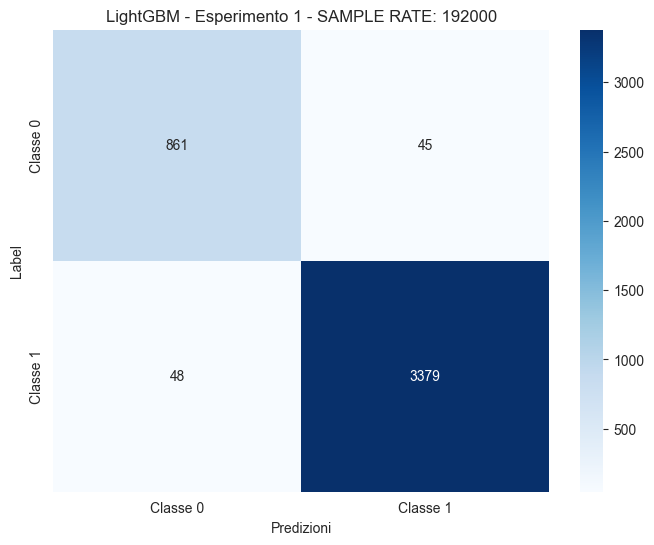

In [21]:
# 1. Effettua le predizioni sul set di convalida
y_pred_lightgbm_19200 = lightgbm_model_19200.predict(X_val_imputed_19200)

# Se il modello restituisce probabilità, ottieni le etichette predette
y_pred_lightgbm_19200 = (y_pred_lightgbm_19200 > 0.5).astype(int)  # Usa la soglia di 0.5 per la classificazione binaria

# 2. Calcola la matrice di confusione
cm_lightgbm_19200 = confusion_matrix(y_val_encoded_19200, y_pred_lightgbm_19200)

# 3. Visualizza la matrice di confusione
plt.figure(figsize=(8, 6))
sns.heatmap(cm_lightgbm_19200, annot=True, fmt='d', cmap='Blues', xticklabels=['Classe 0', 'Classe 1'], yticklabels=['Classe 0', 'Classe 1'])
plt.xlabel('Predizioni')
plt.ylabel('Label')
plt.title('LightGBM - Esperimento 1 - SAMPLE RATE: 192000')
plt.show()

## SAMPLE RATE 384000

In [22]:
resample_dataset(dataset_path, sr=384000)

File C:/Users/mario/OneDrive/Desktop/Resample_exp\Non-Target\Ambient Noise\0f9867d8-fcf7-40d1-b846-3f7fb8100eb7_seg1.wav ricampionato a 384000 Hz e sovrascritto.
File C:/Users/mario/OneDrive/Desktop/Resample_exp\Non-Target\Ambient Noise\0f9867d8-fcf7-40d1-b846-3f7fb8100eb7_seg2.wav ricampionato a 384000 Hz e sovrascritto.
File C:/Users/mario/OneDrive/Desktop/Resample_exp\Non-Target\Ambient Noise\0f9867d8-fcf7-40d1-b846-3f7fb8100eb7_seg3.wav ricampionato a 384000 Hz e sovrascritto.
File C:/Users/mario/OneDrive/Desktop/Resample_exp\Non-Target\Ambient Noise\0f9867d8-fcf7-40d1-b846-3f7fb8100eb7_seg4.wav ricampionato a 384000 Hz e sovrascritto.
File C:/Users/mario/OneDrive/Desktop/Resample_exp\Non-Target\Ambient Noise\0f9867d8-fcf7-40d1-b846-3f7fb8100eb7_seg5.wav ricampionato a 384000 Hz e sovrascritto.
File C:/Users/mario/OneDrive/Desktop/Resample_exp\Non-Target\Ambient Noise\0f9867d8-fcf7-40d1-b846-3f7fb8100eb7_seg6.wav ricampionato a 384000 Hz e sovrascritto.
File C:/Users/mario/OneDrive

In [24]:
df_38400 = features.extract_features_from_directory(dataset_path)

Processing audio files:   0%|          | 0/50993 [00:00<?, ?file/s]C:\Users\mario\AppData\Local\Programs\Python\Python310\lib\site-packages\librosa\feature\spectral.py:2143: UserWarning: Empty filters detected in mel frequency basis. Some channels will produce empty responses. Try increasing your sampling rate (and fmax) or reducing n_mels.
  mel_basis = filters.mel(sr=sr, n_fft=n_fft, **kwargs)
Processing audio files:   0%|          | 219/50993 [01:27<5:40:43,  2.48file/s]C:\Users\mario\AppData\Local\Programs\Python\Python310\lib\site-packages\numpy\core\fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\mario\AppData\Local\Programs\Python\Python310\lib\site-packages\numpy\core\_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
C:\Users\mario\AppData\Local\Programs\Python\Python310\lib\site-packages\numpy\core\_methods.py:129: RuntimeWarning: invalid value e

In [25]:
df_38400.to_csv("resampled_38400_exp1.csv", index=False)

In [26]:
#SPLIT
X_train_imputed_38400, X_val_imputed_38400, X_test_imputed_38400, y_train_encoded_filtered_38400, y_val_encoded_38400, y_test_encoded_38400, subclasses_train, class_encoder_38400 = oversampling_binary.split_dataset("resampled_38400_exp1.csv")

Distribuzione delle classi nel set di addestramento:
Class
Target        34635
Non-Target     5791
Name: count, dtype: int64
Distribuzione delle subclassi nel set di addestramento:
Subclass
Tanker                      9181
Passengership               8847
Tug                         8539
Cargo                       7705
Sperm Whale                 1087
                            ... 
Ringed Seal                    2
Short-finned Pilot Whale       2
Black Drum                     2
Pygmy Right Whale              1
True_s beaked whale            1
Name: count, Length: 107, dtype: int64
Dimensioni del set di addestramento: (40426, 15) (40426,)
Dimensioni del set di validazione: (4333, 15) (4333,)
Dimensioni del set di test: (6234, 15) (6234,)


In [27]:
#SMOTE
X_train_resampled_38400, y_train_resampled_38400 = oversampling_binary.apply_smote(X_train_imputed_38400, y_train_encoded_filtered_38400, subclasses_train)

SMOTE tra le subclass di Target:
Distribuzione subclassi di Target dopo SMOTE:
Subclass
Acoustic Harassment Devices         9181
Acoustic release                    9181
Cargo                               9181
Echosounder                         9181
Explosion                           9181
Fishing pinger                      9181
Passengership                       9181
Scuba divers                        9181
Seafloor fossil fuel processing     9181
Seal bomb                           9181
Seismic airguns surveys             9181
Sonar                               9181
Tanker                              9181
Tug                                 9181
Underwater Communication Signals    9181
Vessel                              9181
Name: count, dtype: int64
SMOTE tra le subclass di Non-Target:
Distribuzione subclassi di Non-Target dopo SMOTE:
Subclass
Ambient Noise         1087
Manatee               1087
Right whale           1087
Red grouper           1087
Rain                  1087

In [28]:
y_train_resampled_38400 = y_train_resampled_38400.astype(int)
y_val_encoded_38400 = y_val_encoded_38400.astype(int)
y_test_encoded_38400 = y_test_encoded_38400.astype(int)

In [29]:
lightgbm_model_38400 = oversampling_binary.train_lightgbm(
    X_train_resampled_38400,
    y_train_resampled_38400,
    X_val_imputed_38400,
    y_val_encoded_38400,
    X_test_imputed_38400,  
    y_test_encoded_38400
)

Training Progress:  30%|███       | 3/10 [00:00<00:00, 17.88it/s]

[LightGBM] [Warning] Contains only one class
[LightGBM] [Info] Number of positive: 0, number of negative: 29379
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000650 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 3825
[LightGBM] [Info] Number of data points in the train set: 29379, number of used features: 15
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.000000 -> initscore=-34.538776
[LightGBM] [Info] Start training from score -34.538776
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the sp

Training Progress:  50%|█████     | 5/10 [00:00<00:00, 11.78it/s]

[LightGBM] [Warning] Contains only one class
[LightGBM] [Info] Number of positive: 0, number of negative: 117516
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.003626 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3825
[LightGBM] [Info] Number of data points in the train set: 117516, number of used features: 15
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.000000 -> initscore=-34.538776
[LightGBM] [Info] Start training from score -34.538776
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because

Training Progress:  70%|███████   | 7/10 [00:01<00:00,  3.37it/s]

[LightGBM] [Info] Number of positive: 146896, number of negative: 88136
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.007131 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3825
[LightGBM] [Info] Number of data points in the train set: 235032, number of used features: 15
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.625004 -> initscore=0.510844
[LightGBM] [Info] Start training from score 0.510844


Training Progress:  80%|████████  | 8/10 [00:02<00:00,  2.43it/s]

[LightGBM] [Info] Number of positive: 146896, number of negative: 117515
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001997 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 3825
[LightGBM] [Info] Number of data points in the train set: 264411, number of used features: 15
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.555559 -> initscore=0.223159
[LightGBM] [Info] Start training from score 0.223159


Training Progress:  90%|█████████ | 9/10 [00:03<00:00,  2.01it/s]

[LightGBM] [Info] Number of positive: 146896, number of negative: 146894
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002744 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 3825
[LightGBM] [Info] Number of data points in the train set: 293790, number of used features: 15
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500003 -> initscore=0.000014
[LightGBM] [Info] Start training from score 0.000014


Training Progress: 100%|██████████| 10/10 [00:04<00:00,  2.48it/s]

Distribuzione delle classi reali (validazione): [ 906 3427]
Distribuzione delle classi predette (validazione): [ 898 3435]
Report di classificazione del set di validazione:
              precision    recall  f1-score   support

           0       0.96      0.95      0.96       906
           1       0.99      0.99      0.99      3427

    accuracy                           0.98      4333
   macro avg       0.97      0.97      0.97      4333
weighted avg       0.98      0.98      0.98      4333

Accuratezza sul set di validazione: 0.9815
Distribuzione delle classi reali (test): [1115 5119]
Distribuzione delle classi predette (test): [ 707 5527]
Report di classificazione del set di test:
              precision    recall  f1-score   support

           0       0.94      0.60      0.73      1115
           1       0.92      0.99      0.95      5119

    accuracy                           0.92      6234
   macro avg       0.93      0.79      0.84      6234
weighted avg       0.92      0.92

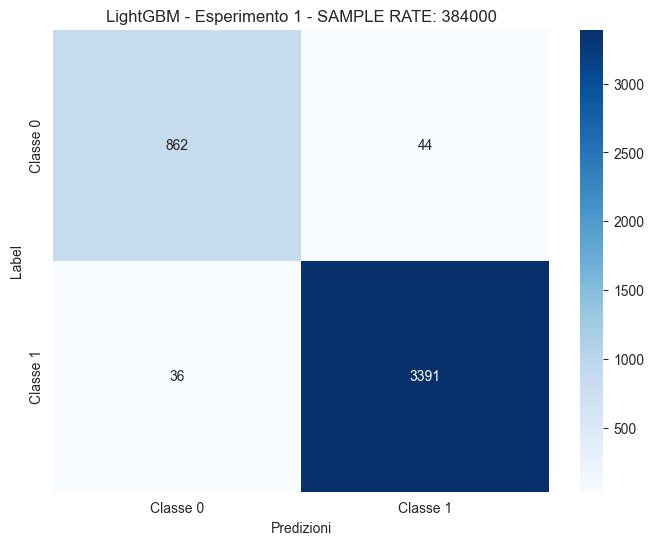

In [30]:
# 1. Effettua le predizioni sul set di convalida
y_pred_lightgbm_38400 = lightgbm_model_38400.predict(X_val_imputed_38400)

# Se il modello restituisce probabilità, ottieni le etichette predette
y_pred_lightgbm_38400 = (y_pred_lightgbm_38400 > 0.5).astype(int)  # Usa la soglia di 0.5 per la classificazione binaria

# 2. Calcola la matrice di confusione
cm_lightgbm_38400 = confusion_matrix(y_val_encoded_38400, y_pred_lightgbm_38400)

# 3. Visualizza la matrice di confusione
plt.figure(figsize=(8, 6))
sns.heatmap(cm_lightgbm_38400, annot=True, fmt='d', cmap='Blues', xticklabels=['Classe 0', 'Classe 1'], yticklabels=['Classe 0', 'Classe 1'])
plt.xlabel('Predizioni')
plt.ylabel('Label')
plt.title('LightGBM - Esperimento 1 - SAMPLE RATE: 384000')
plt.show()